In [1]:
import pandas as pd

## 1. Read some data

In [2]:
data = pd.read_csv("data/Skin_NonSkin.txt",header=None,sep="\t")

In [3]:
data

,0,1,2,3
0,74,85,123,1
1,73,84,122,1
2,72,83,121,1
3,70,81,119,1
4,70,81,119,1
...,...,...,...,...
245052,163,162,112,2
245053,163,162,112,2
245054,163,162,112,2
245055,163,162,112,2


In [4]:
data.isna().sum()

0    0
1    0
2    0
3    0
dtype: int64

In [3]:
X = data.iloc[:,:-1]
y = data.iloc[:,-1]

### something about this data?

In [4]:
y.value_counts()

3
2    194198
1     50859
Name: count, dtype: int64

In [5]:
y.value_counts(normalize=True)

3
2    0.792461
1    0.207539
Name: proportion, dtype: float64

## Let's build some model

In [45]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=142,stratify=y)

In [46]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train_new = scaler.fit_transform(X_train)
X_test_new = scaler.transform(X_test)

In [47]:
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression

### Sample model on unstandarized data

In [48]:
clf = RandomForestClassifier(n_estimators=200)
clf.fit(X_train,y_train)
preds = clf.predict(X_test)
from sklearn.metrics import classification_report as report
print(report(y_test,preds,digits=4))

              precision    recall  f1-score   support

           1     0.9979    0.9997    0.9988     15258
           2     0.9999    0.9995    0.9997     58260

    accuracy                         0.9995     73518
   macro avg     0.9989    0.9996    0.9992     73518
weighted avg     0.9995    0.9995    0.9995     73518



### another model on standarized data

In [49]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train_new = scaler.fit_transform(X_train)
X_test_new = scaler.transform(X_test)

In [50]:
clf = RandomForestClassifier(n_estimators=200)
clf.fit(X_train_new,y_train)
preds = clf.predict(X_test_new)
from sklearn.metrics import classification_report as report
print(report(y_test,preds,digits=4))

              precision    recall  f1-score   support

           1     0.9980    0.9996    0.9988     15258
           2     0.9999    0.9995    0.9997     58260

    accuracy                         0.9995     73518
   macro avg     0.9989    0.9995    0.9992     73518
weighted avg     0.9995    0.9995    0.9995     73518



### Will tSNE help?

In [ ]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, learning_rate='auto',init='random')
X_tr =tsne.fit_transform(X_train_new)
X_te = tsne.transform(X_test_new)

In [ ]:
clf = RandomForestClassifier(n_estimators=200)
clf.fit(X_tr,y_train)
preds = clf.predict(X_te)
from sklearn.metrics import classification_report as report
print(report(y_test,preds,digits=4))

### Compare with PCA?


In [51]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
X_train_pca = pca.fit_transform(X_train_new)
X_test_pca = pca.transform(X_test_new)
print("done transforming...")
clf = RandomForestClassifier(n_estimators=200)
clf.fit(X_train_pca,y_train)
preds = clf.predict(X_test_pca)
from sklearn.metrics import classification_report as report
print(report(y_test,preds,digits=4))

done transforming...
              precision    recall  f1-score   support

           1     0.9802    0.9940    0.9870     15258
           2     0.9984    0.9947    0.9966     58260

    accuracy                         0.9946     73518
   macro avg     0.9893    0.9944    0.9918     73518
weighted avg     0.9946    0.9946    0.9946     73518



### Visualize with PCA

In [17]:
principalDF = pd.DataFrame(data=X_train_pca,columns = ['First PC','Second PC']
                          )
principalDF = pd.concat([principalDF,y],axis=1)

In [13]:
principalDF.head()

,First Principal component,Second Principal component,3
0,-0.509385,0.670113,1
1,-0.110211,-0.412368,1
2,1.416896,0.926607,1
3,-1.945750,-0.481608,1
4,0.499440,-0.451533,1


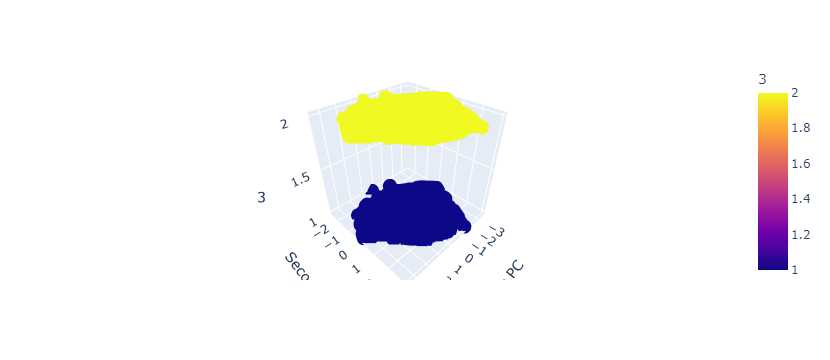

In [18]:
import plotly.express as px
fig = px.scatter_3d(principalDF, x='First PC', y='Second PC', z=3,
              color=3)
fig.show()

In [28]:
pcs = pca.components_

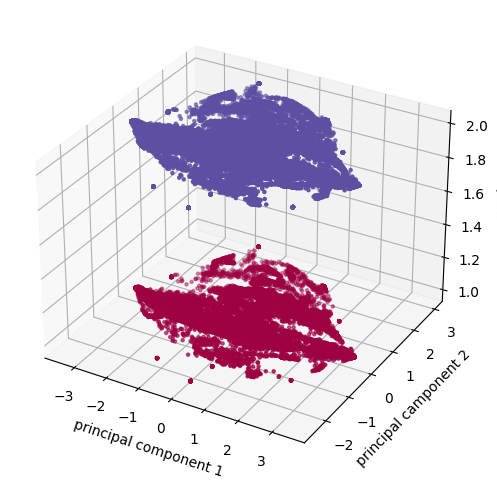

In [31]:
from matplotlib import pyplot as plt
fig = plt.figure(figsize=(6,6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter3D(principalDF['First PC'],
principalDF['Second PC'],
principalDF.iloc[:,-1],
c=principalDF.iloc[:,-1],
marker = '.', cmap = plt.cm.Spectral)


ax.set_xlabel('principal component 1')
ax.set_ylabel('principal camponent 2')
ax.set_zlabel('result')
plt.show()

In [38]:
pcs[0][0]

0.5848077902387742

In [42]:
pca.explained_variance_ratio_

array([0.78417545, 0.17633882])

Text(0, 0.5, '% total variance explained')

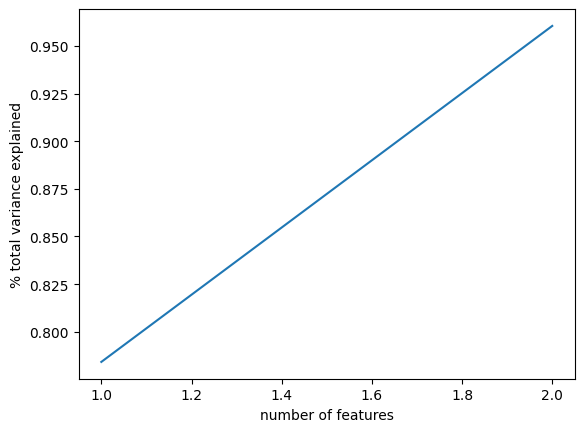

In [44]:
from matplotlib import pyplot as plt
import numpy as np
plt.plot(np.array([1,2]),np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("number of features")
plt.ylabel("% total variance explained")